In [49]:
import numpy as np
import plotly
from tifffile import imread
import matplotlib.pyplot as plt
import stackview
import plotly.graph_objects as go

In [2]:
def plot_volume_plotly(optical_info, voxels_in=None, opacity=0.5, colormap='gray', fig=None):
    '''Plots a 3D array with the non-zero voxels shaded.'''
    voxels = voxels_in * 1.0
    # Check if this is a torch tensor
    if not isinstance(voxels_in, np.ndarray):
        try:
            voxels = voxels.detach()
            voxels = voxels.cpu().abs().numpy()
        except:
            pass
    voxels = np.abs(voxels)
    err = ("The set of voxels are expected to have non-zeros values. If the " +
        "BirefringentVolume was cropped to fit into a region, the non-zero values " +
        "may no longer be included.")
    assert voxels.any(), err

    import plotly.graph_objects as go
    volume_shape = optical_info['volume_shape']
    volume_size_um = [optical_info['voxel_size_um'][i] * optical_info['volume_shape'][i] for i in range(3)]
    # Define grid
    coords = np.indices(np.array(voxels.shape)).astype(float)
    # Shift by half a voxel and multiply by voxel size
    coords = [(coords[i]+0.5) * optical_info['voxel_size_um'][i] for i in range(3)]
    if fig is None:
        fig = go.Figure()
    fig.add_volume(
        x=coords[0].flatten(),
        y=coords[1].flatten(),
        z=coords[2].flatten(),
        value=voxels.flatten() / voxels.max(),
        isomin=0,
        isomax=0.1,
        opacity=opacity, # needs to be small to see through all surfaces
        surface_count=20, # needs to be a large number for good volume rendering
        # colorscale=colormap
        )
    camera = {'eye': {'x': 50, 'y': 0, 'z': 0}}
    fig.update_layout(
        scene=dict(
            xaxis = {"nticks": volume_shape[0], "range": [0, volume_size_um[0]]},
            yaxis = {"nticks": volume_shape[1], "range": [0, volume_size_um[1]]},
            zaxis = {"nticks": volume_shape[2], "range": [0, volume_size_um[2]]},
            xaxis_title='Axial dimension',
            aspectratio = {"x": volume_size_um[0], "y": volume_size_um[1], "z": volume_size_um[2]},
            aspectmode = 'manual'
            ),
        scene_camera=camera,
        margin={'r': 0, 'l': 0, 'b': 0, 't': 0},
        autosize=True
        )
    # fig.data = fig.data[::-1]
    # fig.show()
    return fig

def plot_lines_plotly(self, colormap='Bluered_r', size_scaler=5,
                        fig=None, draw_spheres=True, delta_n_ths=0.1):
    '''Plots the optic axis as lines and the birefringence as sphere
    at the ends of the lines. Other parameters could be opacity=0.5 or mode='lines'
    '''

    # Fetch local data
    delta_n = self.get_delta_n() * 1
    optic_axis = self.get_optic_axis() * 1
    optical_info = self.optical_info

    # Check if this is a torch tensor
    if not isinstance(delta_n, np.ndarray):
        try:
            delta_n = delta_n.cpu().detach().numpy()
            optic_axis = optic_axis.cpu().detach().numpy()
        except:
            pass

    delta_n /= np.max(np.abs(delta_n))
    delta_n[np.abs(delta_n)<delta_n_ths] = 0

    import plotly.graph_objects as go
    volume_shape = optical_info['volume_shape']
    volume_size_um = [optical_info['voxel_size_um'][i] * optical_info['volume_shape'][i] for i in range(3)]
    [dz, dxy, dxy] = optical_info['voxel_size_um']
    # Define grid
    coords = np.indices(np.array(delta_n.shape)).astype(float)

    coords_base = [(coords[i] + 0.5) * optical_info['voxel_size_um'][i] for i in range(3)]
    coords_tip =  [(coords[i] + 0.5 + optic_axis[i,...] * delta_n * 0.75) * optical_info['voxel_size_um'][i] for i in range(3)]

    # Plot single line per voxel, where it's length is delta_n
    z_base, y_base, x_base = coords_base
    z_tip, y_tip, x_tip = coords_tip

    # Don't plot zero values
    mask = delta_n==0
    x_base[mask] = np.NaN
    y_base[mask] = np.NaN
    z_base[mask] = np.NaN
    x_tip[mask] = np.NaN
    y_tip[mask] = np.NaN
    z_tip[mask] = np.NaN

    # Gather all rays in single arrays, to plot them all at once, placing NAN in between them
    array_size = 3 * len(x_base.flatten())
    # Prepare colormap
    all_x = np.empty((array_size))
    all_x[::3] = x_base.flatten()
    all_x[1::3] = x_tip.flatten()
    all_x[2::3] = np.NaN
    all_y = np.empty((array_size))
    all_y[::3] = y_base.flatten()
    all_y[1::3] = y_tip.flatten()
    all_y[2::3] = np.NaN
    all_z = np.empty((array_size))
    all_z[::3] = z_base.flatten()
    all_z[1::3] = z_tip.flatten()
    all_z[2::3] = np.NaN
    # Compute colors
    all_color = np.empty((array_size))
    all_color[::3] =    (x_base-x_tip).flatten() ** 2 + \
                        (y_base-y_tip).flatten() ** 2 + \
                        (z_base-z_tip).flatten() ** 2
    # all_color[::3] =  delta_n.flatten() * 1.0
    all_color[1::3] = all_color[::3]
    all_color[2::3] = 0
    all_color[np.isnan(all_color)] = 0

    err = ("The BirefringentVolume is expected to have non-zeros values. If the " +
        "BirefringentVolume was cropped to fit into a region, the non-zero values " +
        "may no longer be included.")
    assert any(all_color != 0), err

    all_color[all_color!=0] -= all_color[all_color!=0].min()
    all_color += 0.5
    all_color /= all_color.max()

    if fig is None:
        fig = go.Figure()
    fig.add_scatter3d(z=all_x, y=all_y, x=all_z,
        marker={"color": all_color, "colorscale": colormap, "size": 4},
        line={"color": all_color, "colorscale": colormap, "width": size_scaler},
        connectgaps=False,
        mode='lines'
        )
    if draw_spheres:
        fig.add_scatter3d(z=x_base.flatten(), y=y_base.flatten(), x=z_base.flatten(),
            marker={"color": all_color[::3] - 0.5,
                    "colorscale": colormap,
                    "size": size_scaler * 5 * all_color[::3]},
            line={"color": all_color[::3] - 0.5, "colorscale": colormap, "width": 5},
            mode='markers')
    camera = {'eye': {'x': 50, 'y': 0, 'z': 0}}
    fig.update_layout(
        scene=dict(
            xaxis = {"nticks": volume_shape[0], "range": [0, volume_size_um[0]]},
            yaxis = {"nticks": volume_shape[1], "range": [0, volume_size_um[1]]},
            zaxis = {"nticks": volume_shape[2], "range": [0, volume_size_um[2]]},
            xaxis_title = 'Axial dimension',
            aspectratio = {"x": volume_size_um[0], "y": volume_size_um[1], "z": volume_size_um[2]},
            aspectmode = 'manual'
            ),
        scene_camera=camera,
        margin={'r': 0, 'l': 0, 'b': 0, 't': 0},
        )
    # fig.data = fig.data[::-1]
    # fig.show()
    return fig


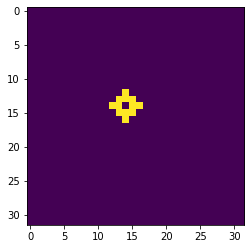

In [3]:
DATA_PATH = "/mnt/efs/shared_data/restorators/spheres"
obj = tifffile.imread(DATA_PATH + '/objects/0001_sphere.tiff')
delta_n = obj[0, ...]
optic_axis = obj[1:, ...]
plt.imshow(delta_n[4, ...])
plt.show(block=True)
plt.pause(0.2)

In [9]:
delta_n.shape

(8, 32, 32)

In [138]:
def plot_surface(delta_n, fig=None, colormap='gray'):
    volume_shape = [8, 32, 32]
    volume_size_um = [1 * volume_shape[i] for i in range(3)]
    voxels = np.abs(delta_n)
    # Define grid
    coords = np.indices(np.array(voxels.shape)).astype(float)
    # Shift by half a voxel and multiply by voxel size
    coords = [(coords[i]+0.5) * volume_size_um[i] for i in range(3)]
    # coords = np.mgrid[:8, :32, :32]
    # fig = None
    if fig is None:
        fig = go.Figure()
    fig.add_volume(
        x=coords[0].flatten(),
        y=coords[1].flatten(),
        z=coords[2].flatten(),
        value=voxels.flatten() / voxels.max(),
        isomin=0,
        isomax=0.1,
        opacity=0.1, # needs to be small to see through all surfaces
        surface_count=20, # needs to be a large number for good volume rendering
        colorscale=colormap
        )
    camera = {'eye': {'x': 50, 'y': 0, 'z': 0}}
    fig.update_layout(
        scene=dict(
            # xaxis = {"nticks": volume_shape[0], "range": [0, volume_size_um[0]]},
            # yaxis = {"nticks": volume_shape[1], "range": [0, volume_size_um[1]]},
            # zaxis = {"nticks": volume_shape[2], "range": [0, volume_size_um[2]]},
            xaxis_title='Axial dim',
            yaxis_title='',
            zaxis_title='',
            aspectratio = {"x": volume_size_um[0], "y": volume_size_um[1], "z": volume_size_um[2]},
            aspectmode = 'manual'
            ),
        scene_camera=camera,
        margin={'r': 0, 'l': 0, 'b': 0, 't': 0},
        # autosize=True,
        scene_xaxis_showticklabels=False,
        scene_yaxis_showticklabels=False,
        scene_zaxis_showticklabels=False,
        )
    return fig

In [44]:
volume_shape = [8, 32, 32]
volume_size_um = [1 * volume_shape[i] for i in range(3)]
voxels = np.abs(delta_n)
# Define grid
coords = np.indices(np.array(voxels.shape)).astype(float)
# Shift by half a voxel and multiply by voxel size
coords = [(coords[i]+0.5) * volume_size_um[i] for i in range(3)]
# coords = np.mgrid[:8, :32, :32]
fig = None
if fig is None:
    fig = go.Figure()
fig.add_volume(
    x=coords[0].flatten(),
    y=coords[1].flatten(),
    z=coords[2].flatten(),
    value=voxels.flatten() / voxels.max(),
    isomin=0,
    isomax=0.1,
    opacity=0.1, # needs to be small to see through all surfaces
    surface_count=20, # needs to be a large number for good volume rendering
    # colorscale=colormap
    )
camera = {'eye': {'x': 50, 'y': 0, 'z': 0}}
fig.update_layout(
    scene=dict(
        # xaxis = {"nticks": volume_shape[0], "range": [0, volume_size_um[0]]},
        # yaxis = {"nticks": volume_shape[1], "range": [0, volume_size_um[1]]},
        # zaxis = {"nticks": volume_shape[2], "range": [0, volume_size_um[2]]},
        xaxis_title='Axial dim',
        yaxis_title='',
        zaxis_title='',
        aspectratio = {"x": volume_size_um[0], "y": volume_size_um[1], "z": volume_size_um[2]},
        # aspectmode = 'manual'
        ),
    scene_camera=camera,
    margin={'r': 0, 'l': 0, 'b': 0, 't': 0},
    # autosize=True,
    scene_xaxis_showticklabels=False,
    scene_yaxis_showticklabels=False,
    scene_zaxis_showticklabels=False,
    )

In [ ]:
X, Y, Z = np.mgrid[0:2:3j, 0:2:3j, 0:2:3j]
values = np.ones(X.shape)*0.1
values[1,1,1] = 1

fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=values.flatten(),
    isomin=0.1,
    isomax=0.8,
    opacity=0.1,  # needs to be small to see through all surfaces
    surface_count=17,  # needs to be a large number for good volume rendering
))
fig.show()

In [ ]:
def cubes(size, pos_x, pos_y, pos_z, color):
    # create points
    x, y, z = np.meshgrid(
        np.linspace(pos_x-size/2, pos_x+size/2, 2), 
        np.linspace(pos_y-size/2, pos_y+size/2, 2), 
        np.linspace(pos_z-size/2, pos_z+size/2, 2),
    )
    x = x.flatten()
    y = y.flatten()
    z = z.flatten()
    
    return go.Mesh3d(x=x, y=y, z=z, alphahull=1, flatshading=True, color=color, lighting={'diffuse': 0.1, 'specular': 2.0, 'roughness': 0.5})

fig = go.Figure()
# set edge length of cubes
size = 5

# add outer cube
fig.add_trace(cubes(20,0,0,0, 'rgba(255,100,0,0.1)'))

# add inner center cube
fig.add_trace(cubes(size,0,0,0, 'rgba(100,0,100,0.1)'))

# add inner cubes
fig.add_trace(cubes(size,size,0,0, 'rgba(100,0,100,0.1)'))
fig.add_trace(cubes(size,-size,0,0, 'rgba(100,0,100,0.1)'))

fig.add_trace(cubes(size,0,size,0, 'rgba(100,0,100,0.1)'))
fig.add_trace(cubes(size,0,-size,0, 'rgba(100,0,100,0.1)'))

fig.add_trace(cubes(size,0,0,size, 'rgba(100,0,100,0.1)'))
fig.add_trace(cubes(size,0,0,-size, 'rgba(100,0,100,0.1)'))

fig.show()

In [ ]:
# Generate nicely looking random 3D-field
np.random.seed(0)
l = 30
X, Y, Z = np.mgrid[:l, :l, :l]
vol = np.zeros((l, l, l))
pts = (l * np.random.rand(3, 15)).astype(int)
vol[tuple(indices for indices in pts)] = 1
from scipy import ndimage
vol = ndimage.gaussian_filter(vol, 4)
vol /= vol.max()

fig = go.Figure(data=go.Volume(
    x=X.flatten(), y=Y.flatten(), z=Z.flatten(),
    value=vol.flatten(),
    isomin=0.2,
    isomax=0.7,
    opacity=0.1,
    surface_count=25,
    ))
fig.update_layout(scene_xaxis_showticklabels=False,
                  scene_yaxis_showticklabels=False,
                  scene_zaxis_showticklabels=False)
fig.show()

In [ ]:
plot_surface(delta_n)

In [58]:
pred_filename = f"../inference/round1/pred.tiff"
gt_filename = f"../inference/round1/gt.tiff"

In [76]:
obj_pred = imread(pred_filename)
delta_n_pred = obj_pred[0, ...]
optic_axis_pred = obj_pred[1:, ...]
obj_gt = imread(gt_filename)
delta_n_gt = obj_gt[0, ...]
optic_axis_gt = obj_gt[1:, ...]

Predicted birefringence

In [74]:
pred_fig = plot_surface(delta_n_pred)
pred_fig.show()

### Optic axis
First let's try to plot the optic axis of the ground truth volume.


In [ ]:
optic_axis_gt.max()
optic_axis[0,...]

In [127]:
op_axis_mag = np.linalg.norm(optic_axis_pred, axis=0)
optic_axis_pred_scaled = optic_axis_pred / op_axis_mag
op_axis = optic_axis_pred_scaled[:, 0, 0, 0]
np.linalg.norm(op_axis)

In [166]:
def plot_lines(delta_n, optic_axis, fig=None):
    # delta_n = delta_n_gt
    # optic_axis = optic_axis_gt

    colormap='Bluered_r'
    size_scaler=5
    draw_spheres=True
    delta_n_ths=0.1
    delta_n /= np.max(np.abs(delta_n))
    delta_n[np.abs(delta_n)<delta_n_ths] = 0

    import plotly.graph_objects as go
    volume_shape = [8, 32, 32]
    volume_size_um = [1 * volume_shape[i] for i in range(3)]
    [dz, dxy, dxy] = volume_size_um
    # Define grid
    coords = np.indices(np.array(delta_n.shape)).astype(float)

    coords_base = [(coords[i] + 0.5) * volume_size_um[i] for i in range(3)]
    coords_tip =  [(coords[i] + 0.5 + optic_axis[i,...] * delta_n * 0.75) * volume_size_um[i] for i in range(3)]

    # Plot single line per voxel, where it's length is delta_n
    z_base, y_base, x_base = coords_base
    z_tip, y_tip, x_tip = coords_tip

    # Don't plot zero values
    mask = delta_n==0
    x_base[mask] = np.NaN
    y_base[mask] = np.NaN
    z_base[mask] = np.NaN
    x_tip[mask] = np.NaN
    y_tip[mask] = np.NaN
    z_tip[mask] = np.NaN

    # Gather all rays in single arrays, to plot them all at once, placing NAN in between them
    array_size = 3 * len(x_base.flatten())
    # Prepare colormap
    all_x = np.empty((array_size))
    all_x[::3] = x_base.flatten()
    all_x[1::3] = x_tip.flatten()
    all_x[2::3] = np.NaN
    all_y = np.empty((array_size))
    all_y[::3] = y_base.flatten()
    all_y[1::3] = y_tip.flatten()
    all_y[2::3] = np.NaN
    all_z = np.empty((array_size))
    all_z[::3] = z_base.flatten()
    all_z[1::3] = z_tip.flatten()
    all_z[2::3] = np.NaN
    # Compute colors
    all_color = np.empty((array_size))
    all_color[::3] =    (x_base-x_tip).flatten() ** 2 + \
                        (y_base-y_tip).flatten() ** 2 + \
                        (z_base-z_tip).flatten() ** 2
    # all_color[::3] =  delta_n.flatten() * 1.0
    all_color[1::3] = all_color[::3]
    all_color[2::3] = 0
    all_color[np.isnan(all_color)] = 0

    err = ("The BirefringentVolume is expected to have non-zeros values. If the " +
        "BirefringentVolume was cropped to fit into a region, the non-zero values " +
        "may no longer be included.")
    assert any(all_color != 0), err

    all_color[all_color!=0] -= all_color[all_color!=0].min()    # twice the length of the nonzero delta_n
    all_color += 0.5
    all_color /= all_color.max()

    if fig is None:
        fig = go.Figure()
    fig.add_scatter3d(z=all_x, y=all_y, x=all_z,
        marker={"color": all_color, "colorscale": colormap, "size": 4},
        line={"color": all_color, "colorscale": colormap, "width": size_scaler},
        connectgaps=False,
        mode='lines'
        )
    if draw_spheres:
        fig.add_scatter3d(z=x_base.flatten(), y=y_base.flatten(), x=z_base.flatten(),
            marker={"color": all_color[::3] - 0.5,
                    "colorscale": colormap,
                    "size": size_scaler * 5 * all_color[::3]},
            line={"color": all_color[::3] - 0.5, "colorscale": colormap, "width": 5},
            mode='markers')
    # camera = {'eye': {'x': 50, 'y': 0, 'z': 0}}
    fig.update_layout(
    #     scene=dict(
    #         xaxis = {"nticks": volume_shape[0], "range": [0, volume_size_um[0]]},
    #         yaxis = {"nticks": volume_shape[1], "range": [0, volume_size_um[1]]},
    #         zaxis = {"nticks": volume_shape[2], "range": [0, volume_size_um[2]]},
    #         xaxis_title = 'Axial dimension',
    #         aspectratio = {"x": volume_size_um[0], "y": volume_size_um[1], "z": volume_size_um[2]},
    #         aspectmode = 'manual'
    #         ),
    #     scene_camera=camera,
        margin={'r': 0, 'l': 0, 'b': 0, 't': 0},
        # layout_showlegend=False,
        )
    fig.update_traces(showlegend=False)
    # fig.data = fig.data[::-1]
    # fig.show()
    return fig

plotting spheres with lines

In [168]:
gt_fig_spheres = plot_lines(delta_n_gt, optic_axis_gt, fig=None)
gt_fig_spheres.show()

In [170]:
pred_fig_spheres = plot_lines(delta_n_pred, optic_axis_pred_scaled, fig=None)
pred_fig_spheres.show()

In [167]:
gt_fig = plot_surface(delta_n_gt)
gt_fig = plot_lines(delta_n_gt, optic_axis_gt, fig=gt_fig)
# gt_fig.update_layout(title='Ground truth')
# gt_fig.update_layout(
#     title={
#         'text': "Plot Title",
#         # 'y':0.9,
#         # 'x':0.5,
#         'xanchor': 'center',
#         'yanchor': 'top'})
gt_fig.update_traces(showlegend=False)
gt_fig.show()

In [169]:
pred_fig = plot_surface(delta_n_pred)
pred_fig = plot_lines(delta_n_pred, optic_axis_pred_scaled, fig=pred_fig)
pred_fig.show()

In [136]:
from plotly.subplots import make_subplots
import ipywidgets as widgets

In [153]:
camera = {'eye': {'x': 50, 'y': 0, 'z': 0}}
fig_widget_gt = go.FigureWidget(gt_fig.data)
# fig_widget_gt.add_title('Ground truth')
fig_widget_gt.update_layout(
    scene=dict(
        xaxis_title='Axial dim',
        yaxis_title='',
        zaxis_title='',
        aspectratio = {"x": volume_size_um[0], "y": volume_size_um[1], "z": volume_size_um[2]},
        aspectmode = 'manual'
        ),
    scene_camera=camera,
    margin={'r': 0, 'l': 0, 'b': 0, 't': 0},
    # autosize=True,
    title='Ground truth',
    scene_xaxis_showticklabels=False,
    scene_yaxis_showticklabels=False,
    scene_zaxis_showticklabels=False,
)
fig_widget_pred = go.FigureWidget(pred_fig.data)
fig_widget_pred.update_layout(
    scene=dict(
        xaxis_title='Axial dim',
        yaxis_title='',
        zaxis_title='',
        aspectratio = {"x": volume_size_um[0], "y": volume_size_um[1], "z": volume_size_um[2]},
        aspectmode = 'manual'
        ),
    scene_camera=camera,
    margin={'r': 0, 'l': 0, 'b': 0, 't': 0},
    # autosize=True,
    title='Predicted volume',
    scene_xaxis_showticklabels=False,
    scene_yaxis_showticklabels=False,
    scene_zaxis_showticklabels=False,
)
widgets.HBox(
    [fig_widget_gt, fig_widget_pred]
    #  go.FigureWidget(pred_fig.data, layout={"height":300})],
)

    'data': [{'isomax': 0.1,
              'isomin': 0,
              'opacity':…

In [158]:
widgets.HBox(
    [go.FigureWidget(gt_fig), go.FigureWidget(pred_fig)],
)

    'data': [{'isomax': 0.1,
              'isomin': 0,
              'opacity':…